In [77]:
x, y = var('x y')
assume(x,'real')
assume(y,'real')

# return dual basis d1, d2 to lattice basis tau1, tau2
def dual_basis(tau1,tau2):
    A = matrix([tau1,tau2])
    X = A.solve_right(identity_matrix(QQ,2))
    d1 = X.transpose()[0]
    d2 = X.transpose()[1]
    return d1, d2

# create coordinate functions
def XY_coords(tau1,tau2):
    d1, d2 = dual_basis(tau1,tau2)
    return 2*pi*d1.dot_product(vector([x,y])), 2*pi*d2.dot_product(vector([x,y]))

# complex-valued lattice wave functions periodic with respect to tau1, tau2 lattice
# these come in a family indexed by integers m, n (the first two variables of the function)
# I've reversed the role of m,n from Farris-Lanning
def lattice_wave(m,n,tau1,tau2):
    X, Y = XY_coords(tau1,tau2)
    return exp(i*(m*X+n*Y))

# act on a 2-variable function by an element of the Euclidean group
# I've chosen to act on the right of a function f by an isometry g via the formula
# (fg)(x,y) = f(g(x,y)) so as to avoid needing to invert g.
def fun_act(f,g):
    return f(g(x,y))

# some isometries
def translate(tau):
    return vector([x,y])+tau

def rotate_origin(theta):
    Rtheta_xy = matrix([[cos(theta), -sin(theta)],[sin(theta),cos(theta)]])*matrix([[x],[y]])
    return vector(Rtheta_xy.list())

def rotate_point(theta,tau):
    trans_rotate = matrix([[cos(theta), -sin(theta)],[sin(theta),cos(theta)]])*matrix([[x-tau[0]],[y-tau[1]]])
    return tau + vector(trans_rotate.list())

For a lattice $\Lambda = \langle \tau_1,\tau_2\rangle$, every complex-linear combination of lattice wave functions will have wallpaper symmetry with translation by $\tau_1,\tau_2$ symmetries. We want to inspect what additional symmetries these functions have.

Question: Does a linear combination of lattice waves (relative to the same basis) always have rotation center at $(0,0)$ or $(\tau_1+\tau_2)/2$? Or some slightly longer list of points?

Answering this question would allow us to develop tests for precise symmetry groups of functions.

For now, some experiments. First we define generators of some particular lattices.

In [58]:
# generic lattice
gen1 = vector([1,0])
gen2 = vector([sqrt(2),1])

# square lattice
sq1 = vector([1,0])
sq2 = vector([0,1])

# rectangular lattice
rec1 = vector([1,0])
rec2 = vector([0,2])

# hex lattice
hex1 = vector([1,0])
hex2 = vector([-1/2,sqrt(3)/2])

Let's look at a "generic" lattice wave on each of these lattices. We plot the real part of the function.

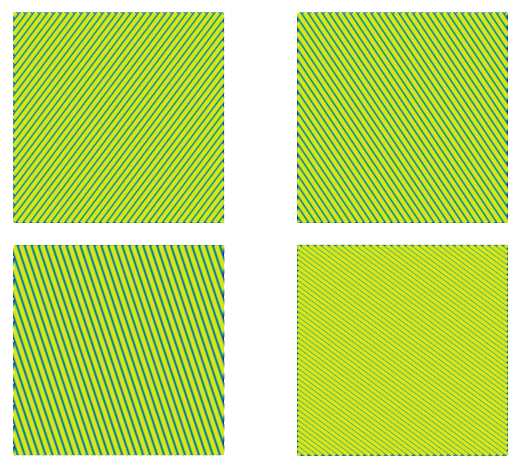

In [66]:
lw_gen = lattice_wave(3,2,gen1,gen2).real()
lw_sq = lattice_wave(3,2,sq1,sq2).real()
lw_rec = lattice_wave(3,2,rec1,rec2).real()
lw_hex = lattice_wave(3,2,hex1,hex2).real()

win = 5
p1 = contour_plot(lw_gen,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p2 = contour_plot(lw_sq,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p3 = contour_plot(lw_rec,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p4 = contour_plot(lw_hex,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)

G = graphics_array([[p1,p2],[p3,p4]])
G

We need to superimpose multiple lattice waves in order to avoid "too much" symmetry.

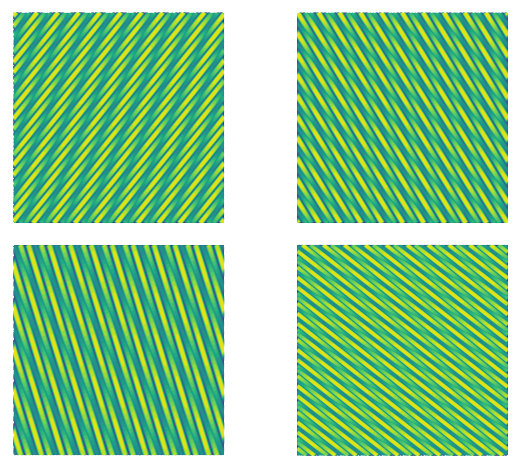

In [67]:
lw_gen = lattice_wave(3,2,gen1,gen2).real()+lattice_wave(2,1,gen1,gen2).real()
lw_sq = lattice_wave(3,2,sq1,sq2).real()+lattice_wave(2,1,sq1,sq2).real()
lw_rec = lattice_wave(3,2,rec1,rec2).real()+lattice_wave(2,1,rec1,rec2).real()
lw_hex = lattice_wave(3,2,hex1,hex2).real()+lattice_wave(2,1,hex1,hex2).real()

win = 5
p1 = contour_plot(lw_gen,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p2 = contour_plot(lw_sq,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p3 = contour_plot(lw_rec,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p4 = contour_plot(lw_hex,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)

G = graphics_array([[p1,p2],[p3,p4]])
G

We can test whether each of these functions admits $\pi/2$ rotation about the origin symmetry.

In [79]:
[bool(lw_gen(x=x,y=y) == lw_gen(x=-x,y=-y)),
 bool(lw_sq(x=x,y=y) == lw_sq(x=-x,y=-y)),
 bool(lw_rec(x=x,y=y) == lw_rec(x=-x,y=-y)),
 bool(lw_rec(x=x,y=y) == lw_rec(x=-x,y=-y))]

[True, True, True, True]

They all do, each has point group at least $C_2$. Some experiments in search of point group $C_1$:

In [80]:
lw_c1 = lattice_wave(3,2,gen1,gen2).real()+lattice_wave(2,1,gen1,gen2).imag()
bool(lw_c1(x=x,y=y) == lw_gen(x=-x,y=-y))

False

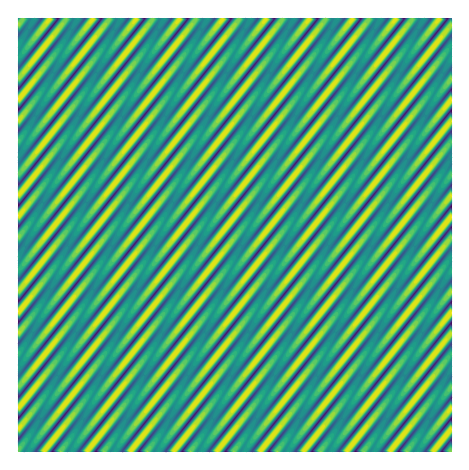

In [81]:
contour_plot(lw_c1,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)

In [82]:
lw_c1

cos(-6*sqrt(2)*pi*y + 6*pi*x + 4*pi*y) + sin(-4*sqrt(2)*pi*y + 4*pi*x + 2*pi*y)

In [83]:
lw_c1(x=-x,y=-y)

cos(6*sqrt(2)*pi*y - 6*pi*x - 4*pi*y) + sin(4*sqrt(2)*pi*y - 4*pi*x - 2*pi*y)

That's nice. This function seems to have symmetry group $p1$. Here are its variants on other lattices:

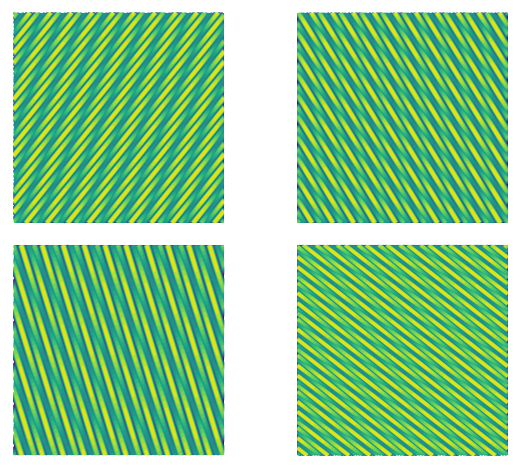

In [84]:
lw_gen = lattice_wave(3,2,gen1,gen2).real()+lattice_wave(2,1,gen1,gen2).imag()
lw_sq = lattice_wave(3,2,sq1,sq2).real()+lattice_wave(2,1,sq1,sq2).imag()
lw_rec = lattice_wave(3,2,rec1,rec2).real()+lattice_wave(2,1,rec1,rec2).imag()
lw_hex = lattice_wave(3,2,hex1,hex2).real()+lattice_wave(2,1,hex1,hex2).imag()

win = 5
p1 = contour_plot(lw_gen,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p2 = contour_plot(lw_sq,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p3 = contour_plot(lw_rec,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)
p4 = contour_plot(lw_hex,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)

G = graphics_array([[p1,p2],[p3,p4]])
G

In [85]:
[bool(lw_gen(x=x,y=y) == lw_gen(x=-x,y=-y)),
 bool(lw_sq(x=x,y=y) == lw_sq(x=-x,y=-y)),
 bool(lw_rec(x=x,y=y) == lw_rec(x=-x,y=-y)),
 bool(lw_rec(x=x,y=y) == lw_rec(x=-x,y=-y))]

[False, False, False, False]

None of them have $\pi/2$ rotational symmetry about the origin! :-)

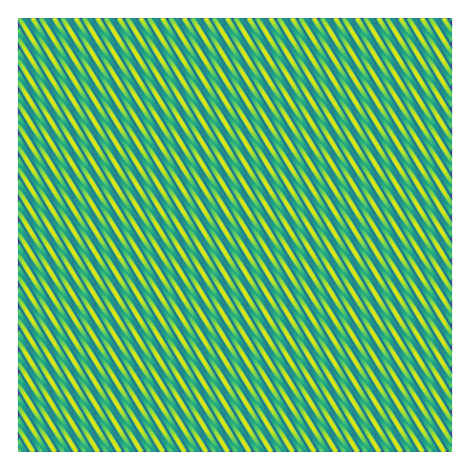

In [99]:
win=10
contour_plot(lw_sq,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)

In [87]:
lw_sq

cos(6*pi*x + 4*pi*y) + sin(4*pi*x + 2*pi*y)

In [92]:
win=2
plot3d(lw_sq,(-win,win),(-win,win),plot_points=500)

Graphics3d Object

In [95]:
# sanity test for lattice symmetry
[bool(lw_sq == lw_sq(x=x+1,y=y)), bool(lw_sq == lw_sq(x=x,y=y+1))]

[True, True]

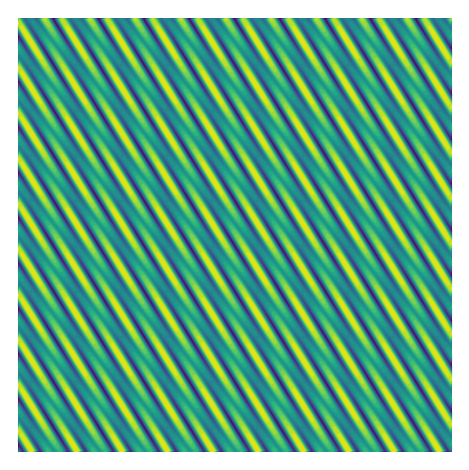

In [102]:
lw_by_hand(x,y) = cos(3*x + 2*y) + sin(2*x + y)

win=30
contour_plot(lw_by_hand,(-win,win),(-win,win),cmap='viridis',plot_points=500,colorbar=False,frame=False,contours=20)